In [57]:
import pandas as pd
import pathlib
import json
from IPython.display import Image
import PIL.Image
import numpy as np
import sklearn.metrics
from PIL import ImageDraw, ImageFont
import torch

In [2]:
RESULT_PATH = '../results/class7_resnet50_batch30_lr1e-05_commit6241653_202112070034'

In [3]:
results = list(pathlib.Path(RESULT_PATH).glob('result_val*'))
last_result = sorted(results)[-1]
params = json.load((pathlib.Path(RESULT_PATH) / 'params.json').open())

In [4]:
params

{'classes': ['北海道旭川市',
  '東京都中央区',
  '東京都千代田区',
  '東京都新宿区',
  '東京都江東区',
  '東京都渋谷区',
  '東京都港区'],
 'batch_size': 30,
 'train_ratio': 0.9,
 'lr': 1e-05,
 'weight_decay': 0,
 'epoch': 200,
 'model': 'resnet50',
 'num_workers': 6,
 'data_sizes': {'train': 26432, 'val': 2937},
 'git_commit_id': '6241653',
 'use_gpu': True}

In [5]:
result_df = pd.read_csv(last_result)

In [6]:
row = result_df.iloc[0]
row

Unnamed: 0                                                        0
predict                                                           3
label                                                             3
file_index                                                    19779
score[北海道旭川市]                                             -0.152041
score[東京都中央区]                                              -11.8034
score[東京都千代田区]                                             -7.90261
score[東京都新宿区]                                               2.88916
score[東京都江東区]                                              -6.94946
score[東京都渋谷区]                                                -1.639
score[東京都港区]                                                -2.0755
file              data/東京都新宿区/白銀町/35.70424624473834139.738021826...
labels_file                                                       3
Name: 0, dtype: object

In [108]:
import numpy as np
def softmax(x):
    """Compute softmax values for each sets of scores in x."""
    e_x = np.exp(x - np.max(x))
    return e_x / e_x.sum(axis=0) # only difference

In [73]:
score_columns

NameError: name 'score_columns' is not defined

In [28]:
image.save('out.gif')

In [127]:
def imagedraw(
    row, params, target=None, place=True, show_result=True,
    subtitle=None
    ):
    image = PIL.Image.open('../'+row.file)
    draw = ImageDraw.Draw(image)
    font = ImageFont.truetype("ヒラギノ角ゴシック W7.ttc", size=40)
    if show_result:
        text = "予測: " + params["classes"][row.predict]
        draw.text((70, 170), text, font=font, fill=(255, 0, 0))
        text = "正解: " + params["classes"][row.label]
        draw.text((70, 220), text, font=font, fill=(255, 255, 255))
    if target:
        score_columns = [key for key in row.keys() if key.find("score") >= 0]
        score = softmax(row[score_columns].tolist())
        row_scored = {key: value for key, value in zip(score_columns, score)}
        text = f"{target}スコア: \n{row_scored[f'score[{target}]']: .3f}"
        draw.text((70, 290), text, font=font, fill=(255, 255, 255))
    if place:
        p = pathlib.Path(row.file).parent.stem
        draw.text((20, 20), p, font=font, fill=(0, 0, 255))
    if subtitle:
        draw.text((20, 20), p, font=font, fill=(0, 0, 255))

    return image


In [60]:
row.keys()

Index(['Unnamed: 0', 'predict', 'label', 'file_index', 'score[北海道旭川市]',
       'score[東京都中央区]', 'score[東京都千代田区]', 'score[東京都新宿区]', 'score[東京都江東区]',
       'score[東京都渋谷区]', 'score[東京都港区]', 'file', 'labels_file'],
      dtype='object')

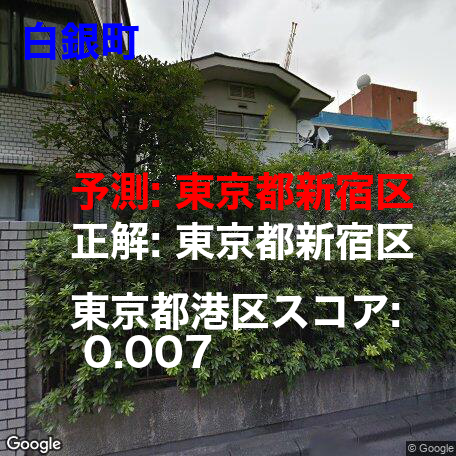

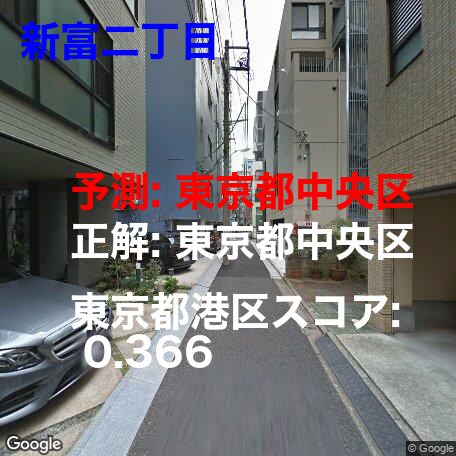

In [116]:
images = []
for i, row in result_df.iterrows():
    # image = PIL.Image.open('../'+row.file)
    # draw = ImageDraw.Draw(image)
    # font = ImageFont.truetype("ヒラギノ角ゴシック W7.ttc", size=40)
    # text = "予測: " + params["classes"][row.predict]
    # draw.text((70, 170), text, font=font, fill=(255, 0, 0))
    # text = "正解: " + params["classes"][row.label]
    # draw.text((70, 220), text, font=font, fill=(255, 255, 255))
    image = imagedraw(row, params, target="東京都港区")
    display(image)
    image.save(f"{i}.png")
    images.append(image)
    if i == 1:
        break
images[0].save('out.gif', save_all=True, append_images=images[1:], duration=500, loop=0)

In [87]:
np.exp(np.array(
    [-3.04120302, -14.6925696, -10.791768600000001, 0.0, -9.8386206, -4.5281571000000005, -4.9646588]))

array([4.77773778e-02, 4.16004566e-07, 2.05681129e-05, 1.00000000e+00,
       5.33508526e-05, 1.08005621e-02, 6.98033199e-03])

# 最もXXX区らしいYYY

北海道旭川市 北海道旭川市
北海道旭川市 東京都中央区
北海道旭川市 東京都千代田区
北海道旭川市 東京都新宿区
北海道旭川市 東京都江東区
北海道旭川市 東京都渋谷区
北海道旭川市 東京都港区
東京都中央区 北海道旭川市
東京都中央区 東京都中央区
東京都中央区 東京都千代田区
東京都中央区 東京都新宿区
東京都中央区 東京都江東区
東京都中央区 東京都渋谷区
東京都中央区 東京都港区
東京都千代田区 北海道旭川市
東京都千代田区 東京都中央区
東京都千代田区 東京都千代田区
東京都千代田区 東京都新宿区
東京都千代田区 東京都江東区
東京都千代田区 東京都渋谷区
東京都千代田区 東京都港区
東京都新宿区 北海道旭川市
東京都新宿区 東京都中央区
東京都新宿区 東京都千代田区
東京都新宿区 東京都新宿区
東京都新宿区 東京都江東区
東京都新宿区 東京都渋谷区
東京都新宿区 東京都港区
東京都江東区 北海道旭川市
東京都江東区 東京都中央区
東京都江東区 東京都千代田区
東京都江東区 東京都新宿区
東京都江東区 東京都江東区
東京都江東区 東京都渋谷区
東京都江東区 東京都港区
東京都渋谷区 北海道旭川市
東京都渋谷区 東京都中央区
東京都渋谷区 東京都千代田区
東京都渋谷区 東京都新宿区
東京都渋谷区 東京都江東区
東京都渋谷区 東京都渋谷区
東京都渋谷区 東京都港区
東京都港区 北海道旭川市
東京都港区 東京都中央区
東京都港区 東京都千代田区
東京都港区 東京都新宿区
東京都港区 東京都江東区
東京都港区 東京都渋谷区
東京都港区 東京都港区


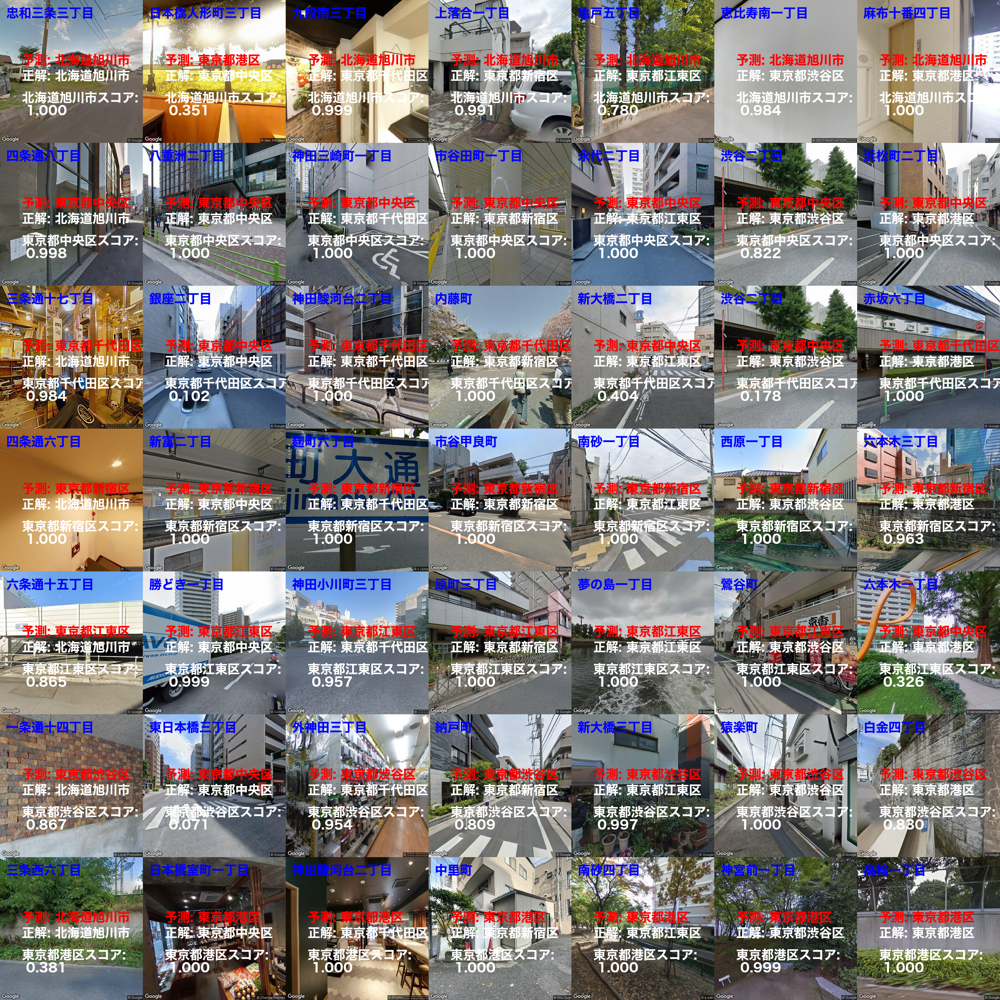

In [120]:
sample = imagedraw(result_df.iloc[0], params)
result_img = PIL.Image.new(
    'RGB', 
    (
        sample.width * len(params["classes"]), 
        sample.height * len(params["classes"])))
for i_a, class_a in enumerate(params["classes"]):
    for i_b, class_b in enumerate(params["classes"]):
        r = result_df.query(f'file.str.contains("{class_a}")').sort_values(f'score[{class_b}]', ascending=False).head(1).iloc[0]
        image = imagedraw(r, params, target=class_b)
        result_img.paste(image, (i_a * sample.width, i_b*sample.height))
        print(class_a, class_b)
display(result_img.resize((1000, 1000)))


In [107]:
pathlib.Path(row.file).parent.stem

'台場二丁目'

# most 港区

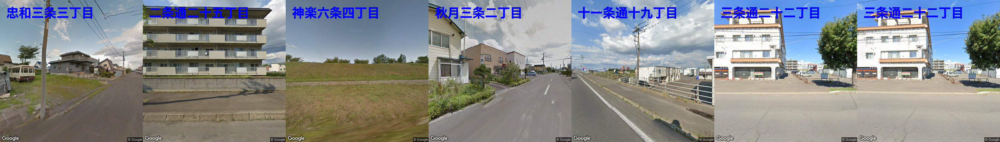

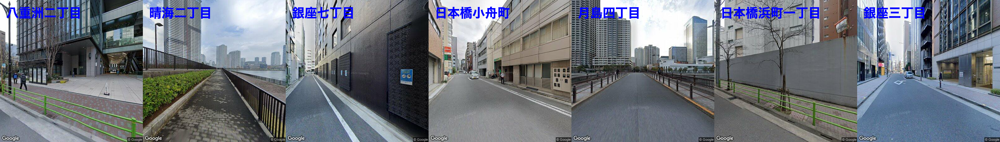

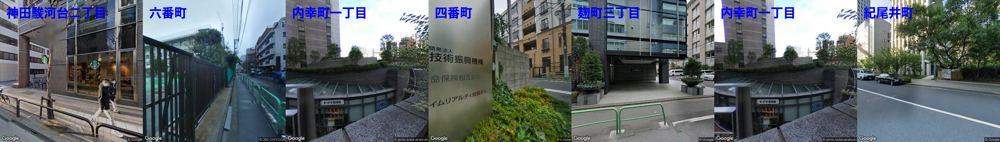

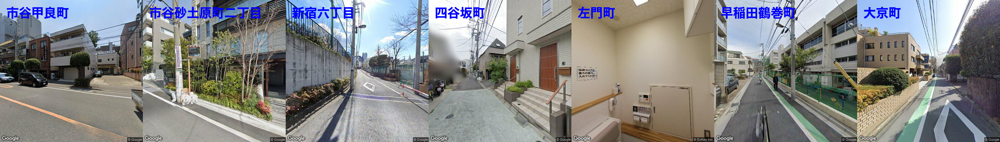

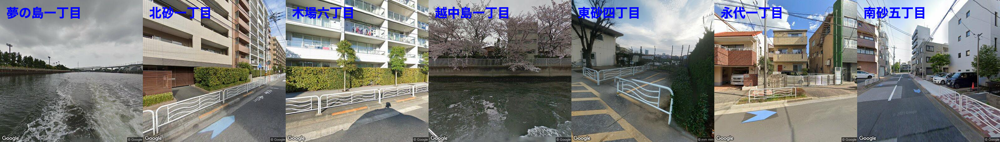

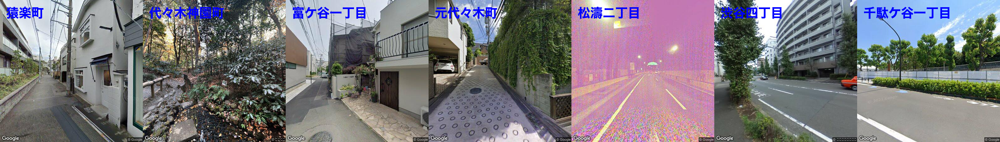

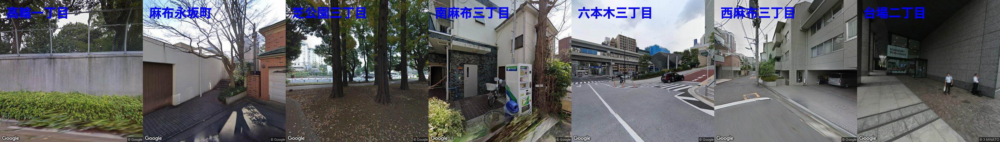

In [131]:
sample = imagedraw(result_df.iloc[0], params)
N = 7
for i_a, class_a in enumerate(params["classes"]):
    soreted_df = result_df.query(f'file.str.contains("{class_a}")').sort_values(f'score[{class_a}]', ascending=False)
    result_img = PIL.Image.new(
        'RGB', 
        (
            sample.width * N, 
            sample.height)
    )
    for i, (i_orig, row) in enumerate(soreted_df.head(N).iterrows()):
        image = imagedraw(row, params, show_result=False)
        result_img.paste(image, (i * sample.width, 0))
    display(result_img)
    result_img.save(f'{class_a}_top7.png')
